# The Battle of Neighborhoods - 2

In this week, you will continue working on your capstone project. Please remember by the end of this week, you will need to submit the following:

1. A full report consisting of all of the following components (15 marks):
    - Introduction where you discuss the business problem and who would be interested in this project.
    - Data where you describe the data that will be used to solve the problem and the source of the data.
    - Methodology section which represents the main component of the report where you discuss and describe any exploratory data analysis that you did, any inferential statistical testing that you performed, and what machine learnings were used and why.
    - Results section where you discuss the results.
    - Discussion section where you discuss any observations you noted and any recommendations you can make based on the results.
    - Conclusion section where you conclude the report.
    
2. A link to your Notebook on your Github repository pushed showing your code. (15 marks)

3. Your choice of a presentation or blogpost. (10 marks)

Here are examples of previous outstanding submissions that should give you an idea of what your report would look like, what your notebook would look like in terms of clean, clear, and well-commented code, and what your presentation would look like or your blogpost would look like:

Report: https://cocl.us/coursera_capstone_report

Notebook: https://cocl.us/coursera_capstone_notebook

Presentation: https://cocl.us/coursera_capstone_presentation

Blogpost: https://cocl.us/coursera_capstone_blogpost

# Introduction

As global warming becomes a buzz word today, more and more people are beginning to realize that individual diet can affect global warming, especially in developed countries. China is also making active efforts to reduce carbon emissions, but there are too few Chinese who realize that their diet will have an impact on the environment. So a lot of non-profit organization want to poromote more environmentally friendly eating habits in China.

While, China has a vast territory, and the consumption levels and consumption habits are affected by factors such as economic level and cultural characteristics in different regions. In some regions just entering the era of affluence, the level of meat consumption is rising rapidly; some areas are affected by geography and tradition, and have special dependence on certain meats; the animal industry in developed regions is reduced or removed to rural areas because of the increasingly strict environmental control...

Chinese people are more likely to follow their traditional Chinese eating habits if the promotion of more environmentally friendly eating habits is not targeted to a particular region.

# Data

The data set about Chinese people's main food consumption comes from [China Statistics Bureau](http://www.stats.gov.cn/tjsj/ndsj/2018/indexch.htm). It shows per capita consumption of the main animal products, such as pork, beef, birds meat, aquatic product, egg and milk in different provinces of China.

Visualize data to see where people like to eat what kind of animals in China different provinces.

# Methodology

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

import datetime

In [2]:
df = pd.read_csv('food_consumption_areas'+'.csv')
print(df.shape)
display(df.head())

(192, 20)


,AreaNum,Area,省区名,Year,Urban or Rural,Grain (Paddy Equivalent),Rice (Paddy Equivalent),Edible Oil,Vegetable Oil,Vegetable & Fungus,Livestock Meat,Pork Meat,Bovine Meat,Mutton & Goat Meat,Poultry Meat,Aquatic,Egg,Milk,Melon & Fruit,Sugar
0,0,"China, mainland",中国大陆,2015,Urban,112.6,101.6,11.1,10.7,104.4,28.9,20.7,2.4,1.5,9.4,14.7,10.5,17.1,55.1,1.3
1,1,Beijing,北京,2015,Urban,88.5,79.2,11.0,11.0,102.1,26.4,14.0,3.6,3.1,6.3,10.3,14.0,28.9,71.5,0.8
2,2,Tianjin,天津,2015,Urban,118.4,109.0,10.7,10.7,116.7,26.1,16.0,3.0,3.2,5.2,17.6,17.1,18.5,74.0,1.3
3,3,Hebei,河北,2015,Urban,115.8,105.7,9.7,9.6,94.7,22.8,13.6,2.1,1.9,5.2,7.5,13.7,21.2,63.4,1.0
4,4,Shanxi,山西,2015,Urban,110.7,98.2,8.2,8.1,85.2,16.7,10.6,1.0,1.7,2.7,4.9,11.4,20.6,60.1,0.8


In [3]:
df = df[~df['Area'].isin(['China, mainland'])]
df = df[df['Year']==2017]
df = df.sort_values(['AreaNum','Urban or Rural'])
df.reset_index(inplace=True)
df = df.drop(columns=['index'])
display(df.head())

,AreaNum,Area,省区名,Year,Urban or Rural,Grain (Paddy Equivalent),Rice (Paddy Equivalent),Edible Oil,Vegetable Oil,Vegetable & Fungus,Livestock Meat,Pork Meat,Bovine Meat,Mutton & Goat Meat,Poultry Meat,Aquatic,Egg,Milk,Melon & Fruit,Sugar
0,1,Beijing,北京,2017,Rural,96.7,86.9,9.0,9.0,88.7,22.2,14.4,1.7,3.0,4.0,5.6,11.8,12.9,51.7,1.2
1,1,Beijing,北京,2017,Urban,72.4,64.0,8.2,8.2,92.4,23.1,12.4,3.1,2.8,5.7,9.0,12.1,24.0,65.8,1.0
2,2,Tianjin,天津,2017,Rural,153.9,142.9,12.8,12.7,99.0,22.0,14.4,0.9,2.3,4.1,12.6,16.7,12.0,81.8,1.7
3,2,Tianjin,天津,2017,Urban,112.9,102.6,10.5,10.4,120.0,27.5,16.2,3.5,3.3,6.0,17.8,18.6,18.4,86.1,1.4
4,3,Hebei,河北,2017,Rural,134.3,125.8,9.5,9.3,75.1,15.9,10.9,0.5,0.9,3.2,3.7,13.0,8.3,51.5,1.2


In [4]:
# font size
TIT_size = 14    # titles
LAB_size = 13    # labels
LEG_size = 13    # legends
TCK_size = 12    # ticklabels

LIN_wei = 2.5    # line weights
BAR_wid = 0.8    # bar width

def setX_areas(ax, ticks):
    ax.set_xticklabels(ticks, rotation=90, ha='center', fontsize=TCK_size)
    ax.set_xlabel('Areas', fontsize=LAB_size)
    
def setY_wei(ax, ticks):
    ax.set_yticks(ticks)
    ax.set_ylim(ticks[0],ticks[-1])
    ax.set_yticklabels(ticks, fontsize=TCK_size)
    ax.set_ylabel('Weight (kg/capita/year)', fontsize=LAB_size)

def setY_per(ax):
    ticks=np.round(np.linspace(0.00, 1.00, num=11, endpoint=True), decimals=2)
    ax.set_yticks(ticks)
    ax.set_ylim(ticks[0],ticks[-1])
    ax.set_yticklabels(ticks, fontsize=TCK_size)
    ax.set_ylabel('Percentage (%)', fontsize=LAB_size)
    
def setSpi_LB(ax):
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

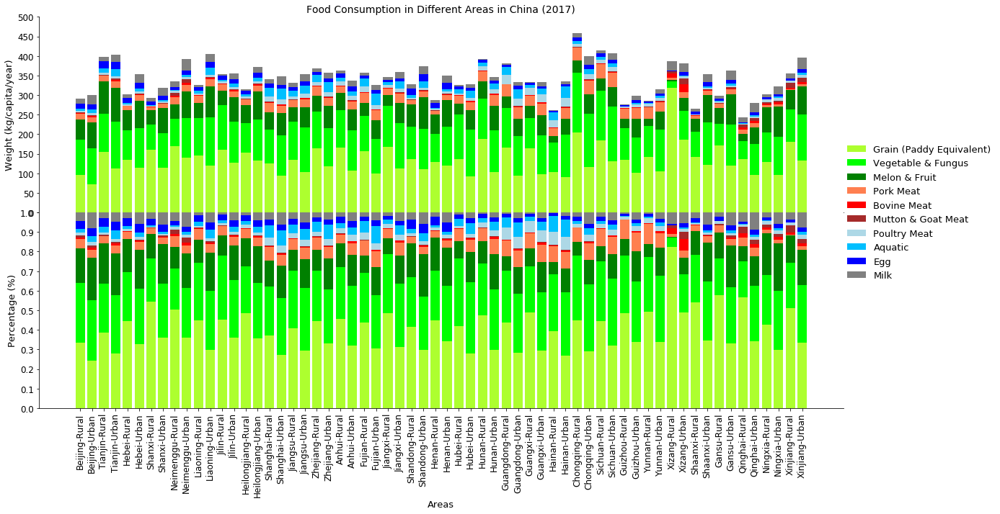

In [5]:
areas_multi = list(df[['Area','Urban or Rural']].values)

areas = []
for a in areas_multi:
    area = a[0]+'-'+a[1]
    areas.append(area)

cols = ['Grain (Paddy Equivalent)','Vegetable & Fungus','Melon & Fruit',
        'Pork Meat', 'Bovine Meat','Mutton & Goat Meat',
        'Poultry Meat','Aquatic', 'Egg', 'Milk']

CLs = ['greenyellow', 'lime','g',
       'coral','r','brown',
       'lightblue', 'deepskyblue', 'b','gray']

title = "Food Consumption in Different Areas in China (2017)"

fig = plt.figure(figsize = (20,10))
fig.tight_layout()                        
plt.subplots_adjust(wspace=0., hspace =0.)
    
# -------------------------------------------------------------------------------------------
ax1 = fig.add_subplot(2,1,1)
plt.title(title, fontsize=TIT_size)

bot = np.zeros(len(areas))
for n in range(0,len(cols)):
    plt.bar(areas, df[cols[n]].values, bottom=bot,color=CLs[n], width=BAR_wid)
    bot=bot + df[cols[n]].values

total = bot

ax=plt.gca()
ax.legend=False
setSpi_LB(ax)
plt.xticks([])
setY_wei(ax, range(0, 550, 50))

# #-------------------------------------------------------------------------------------------------

ax2 = fig.add_subplot(2,1,2)

bot = np.zeros(len(areas))
for n in range(0,len(cols)):
    plt.bar(areas, df[cols[n]].values/total, bottom=bot,color=CLs[n], width=BAR_wid)
    bot=bot + df[cols[n]].values/total
    
ax=plt.gca()
ax.legend(labels=cols, loc='center left', frameon=False, fontsize=LEG_size,
           bbox_to_anchor=(1.,1.),borderaxespad = 0.)
setSpi_LB(ax)
setX_areas(ax, areas)
setY_per(ax)

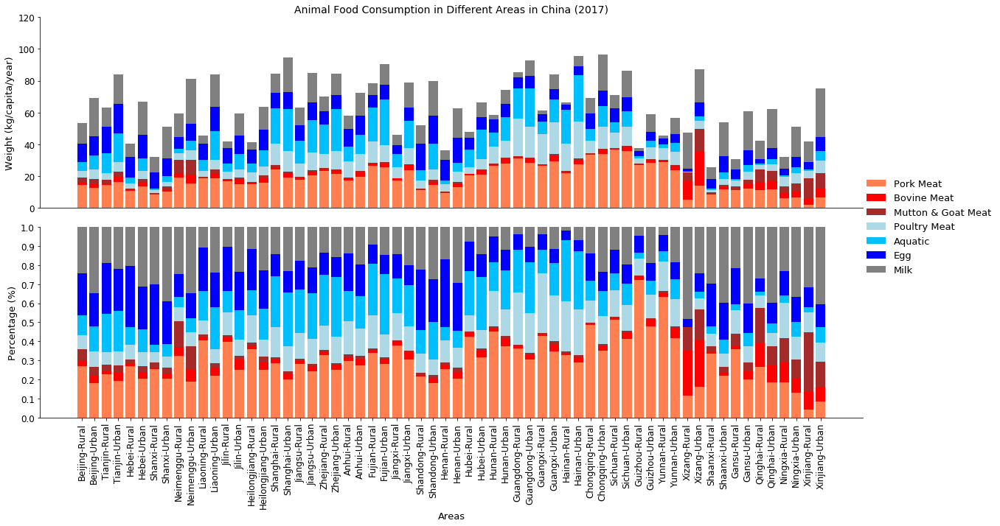

In [6]:
areas_multi = list(df[['Area','Urban or Rural']].values)

areas = []
for a in areas_multi:
    area = a[0]+'-'+a[1]
    areas.append(area)

cols = ['Pork Meat', 'Bovine Meat','Mutton & Goat Meat',
        'Poultry Meat', 'Aquatic', 'Egg', 'Milk']

CLs = ['coral','r','brown','lightblue', 'deepskyblue', 'b', 'gray']

title = "Animal Food Consumption in Different Areas in China (2017)"

fig = plt.figure(figsize = (20,10))
fig.tight_layout()                        
plt.subplots_adjust(wspace=0., hspace =0.1)
    
# -------------------------------------------------------------------------------------------
ax1 = fig.add_subplot(2,1,1)
plt.title(title, fontsize=TIT_size)

bot = np.zeros(len(areas))
for n in range(0,len(cols)):
    plt.bar(areas, df[cols[n]].values, bottom=bot,color=CLs[n], width=BAR_wid)
    bot=bot + df[cols[n]].values

total = bot

ax=plt.gca()
ax.legend=False
setSpi_LB(ax)
plt.xticks([])
setY_wei(ax, range(0, 140, 20))

# #-------------------------------------------------------------------------------------------------

ax2 = fig.add_subplot(2,1,2)

bot = np.zeros(len(areas))
for n in range(0,len(cols)):
    plt.bar(areas, df[cols[n]].values/total, bottom=bot,color=CLs[n], width=BAR_wid)
    bot=bot + df[cols[n]].values/total
    
ax=plt.gca()
ax.legend(labels=cols, loc='center left', frameon=False, fontsize=LEG_size,
           bbox_to_anchor=(1.,1.),borderaxespad = 0.)
setSpi_LB(ax)
setX_areas(ax, areas)
setY_per(ax)

In [93]:
import folium
import json
import time
# import folium.colormap as cm

cn_geo = r'cn_provinces.geojson'

def mkMap(df, df_, ind_col, val_col, color, leg_name):

    df_temp = df_
# ---------------------------------------------------------------------------------- #
    # 在该字段的所有年份的数据范围内选择最大值和最小值 #
# ---------------------------------------------------------------------------------- #
    threshold_scale = np.linspace(df[val_col].min(),
                                  df[val_col].max(),
                                  6, dtype=int)
    
# ---------------------------------------------------------------------------------- #
# --------- 仅使用当前年份数据选择最大值和最小值 ------------------------ #
# ---------------------------------------------------------------------------------- #

#     threshold_scale = np.linspace(df_temp[val_col].min(),
#                                   df_temp[val_col].max(),
#                                   6, dtype=int)
    
    # change the numpy array to a list
    threshold_scale = threshold_scale.tolist()

    # make sure that the last value of the list is greater than the maximum immigration
    threshold_scale[-1] = threshold_scale[-1] + 1

    # let Folium determine the scale.
    cn_map = folium.Map(
        width=1000,height=600,
        location=[40, 105], 
        zoom_start=4, 
        tiles='Mapbox Bright')

    cn_map.choropleth(
        geo_data=cn_geo,
        data=df_temp,
        columns=[ind_col, val_col],
        key_on='feature.properties.NAME',   # must be 'feature', not 'features'
        threshold_scale=threshold_scale,
        fill_color=color, 
        fill_opacity=0.9, 
        line_opacity=0.2,
        highlight=True,
        legend_name=leg_name,
        reset=True
    )
    return cn_map

In [64]:
df_urb = df[df['Urban or Rural'] == 'Urban']
df_rur = df[df['Urban or Rural'] == 'Rural']

In [106]:
vals = 'Pork Meat'
mkMap(df, df_urb, 'Area', vals, 'OrRd', vals+' Consumption in Urban (Unit: kg/capita/year; Year: 2017)')

In [113]:
vals = 'Pork Meat'
mkMap(df, df_rur, 'Area', vals, 'OrRd', vals+' Consumption in Rural (Unit: kg/capita/year; Year: 2017)')

In [114]:
vals = 'Bovine Meat'
mkMap(df, df_urb, 'Area', vals, 'OrRd', vals+' Consumption in Urban (Unit: kg/capita/year; Year: 2017)')

In [115]:
vals = 'Bovine Meat'
mkMap(df, df_rur, 'Area', vals, 'OrRd', vals+' Consumption in Rural (Unit: kg/capita/year; Year: 2017)')

In [116]:
vals = 'Mutton & Goat Meat'
mkMap(df, df_urb, 'Area', vals, 'OrRd', vals+' Consumption in Urban (Unit: kg/capita/year; Year: 2017)')

In [117]:
vals = 'Mutton & Goat Meat'
mkMap(df, df_rur, 'Area', vals, 'OrRd', vals+' Consumption in Rural (Unit: kg/capita/year; Year: 2017)')

In [118]:
vals = 'Poultry Meat'
mkMap(df, df_urb, 'Area', vals, 'OrRd', vals+' Consumption in Urban (Unit: kg/capita/year; Year: 2017)')

In [119]:
vals = 'Poultry Meat'
mkMap(df, df_rur, 'Area', vals, 'OrRd', vals+' Consumption in Rural (Unit: kg/capita/year; Year: 2017)')

In [120]:
vals = 'Aquatic'
mkMap(df, df_urb, 'Area', vals, 'OrRd', vals+' Consumption in Urban (Unit: kg/capita/year; Year: 2017)')

In [121]:
vals = 'Aquatic'
mkMap(df, df_rur, 'Area', vals, 'OrRd', vals+' Consumption in Rural (Unit: kg/capita/year; Year: 2017)')

In [122]:
vals = 'Egg'
mkMap(df, df_urb, 'Area', vals, 'OrRd', vals+' Consumption in Urban (Unit: kg/capita/year; Year: 2017)')

In [123]:
vals = 'Egg'
mkMap(df, df_rur, 'Area', vals, 'OrRd', vals+' Consumption in Rural (Unit: kg/capita/year; Year: 2017)')

In [124]:
vals = 'Milk'
mkMap(df, df_urb, 'Area', vals, 'OrRd', vals+' Consumption in Rural (Unit: kg/capita/year; Year: 2017)')

In [125]:
vals = 'Milk'
mkMap(df, df_rur, 'Area', vals, 'OrRd', vals+' Consumption in Rural (Unit: kg/capita/year; Year: 2017)')

# Results

1. In China, 75% - 95% of meal are grain, vegetable, fungus, fruit and melon.
2. By weight, Chongqing consumption the most of food, much higher than the second Sichuan.
3. Pork meat is the most popular in most provinces, exept Xinjiang, Xizang, Qinghai, Neimeng, Ningxia.
4. In south of China, people like pork meat and poultry meat, in north of China, people like bovine meat, in north west, people like milk and bovine meat, mutton and goat meat.
5. In urban, people eat much more milk than rural area. Then is egg.

# Discussion

Why milk and egg is more popular then rural area?
There's a hypothesis: urban has more school age children, egg and milk is the most affordable and conveniont protein.

# Conclussion

Most potentiality for promoting Vegetarian-based meal is in urban of provinces those are not so developed.